# Investigation into Fatal Motor Vehicle Accidents in Australia - 1989-2021

https://data.gov.au/dataset/ds-dga-5b530fb8-526e-4fbf-b0f6-aa24e84e4277/details?q=crash

In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

pd.set_option('display.max_columns', None, 'display.max_rows', None)

%matplotlib inline  
plt.style.use('fivethirtyeight')
sns.set(style='whitegrid',color_codes=True)

In [25]:
df = pd.read_csv('ardd_fatalities_apr_2021.csv', low_memory=False, na_values='-9', index_col = 'Crash ID')

In [26]:
df.head()

,State,Month,Year,Dayweek,Time,Crash Type,Bus Involvement,Heavy Rigid Truck Involvement,Articulated Truck Involvement,Speed Limit,Road User,Gender,Age,National Remoteness Areas,SA4 Name 2016,National LGA Name 2017,National Road Type,Christmas Period,Easter Period,Age Group,Day of week,Time of day
Crash ID,,,,,,,,,,,,,,,,,,,,,,
20215020,WA,4,2021,Tuesday,16:00:00,Single,No,No,No,NaN,Pedestrian,Male,3.0,NaN,NaN,NaN,NaN,No,No,0_to_16,Weekday,Day
20212067,Vic,4,2021,Thursday,18:00:00,Multiple,NaN,NaN,NaN,NaN,Motorcycle rider,Male,55.0,Inner Regional Australia,Latrobe - Gippsland,Baw Baw (S),Arterial Road,No,No,40_to_64,Weekday,Night
20213015,Qld,4,2021,Sunday,23:00:00,Single,No,No,No,70,Driver,Male,21.0,Inner Regional Australia,Darling Downs - Maranoa,Southern Downs (R),National or State Highway,No,No,17_to_25,Weekend,Night
20211009,NSW,4,2021,Thursday,21:05:00,Single,No,Yes,No,110,Pedestrian,Female,21.0,Major Cities of Australia,Newcastle and Lake Macquarie,Lake Macquarie,National or State Highway,No,No,17_to_25,Weekday,Night
20211054,NSW,4,2021,Saturday,04:25:00,Single,No,No,No,80,Passenger,Male,5.0,Inner Regional Australia,Southern Highlands and Shoalhaven,Shoalhaven,National or State Highway,No,No,0_to_16,Weekend,Night


In [27]:
df.shape

(52397, 22)

In [28]:
def clean_column_name(column_names):
    clean_column_names = []
    for c in column_names:
        c = c.lower().replace(' ', '_')
        clean_column_names.append(c)
        
    return clean_column_names

In [29]:
df.columns = clean_column_name(df.columns)

In [30]:
df.isnull().sum()

state                                0
month                                0
year                                 0
dayweek                              0
time                                40
crash_type                           0
bus_involvement                     16
heavy_rigid_truck_involvement    20509
articulated_truck_involvement       16
speed_limit                       1384
road_user                            0
gender                              28
age                                 89
national_remoteness_areas        45650
sa4_name_2016                    45636
national_lga_name_2017           45635
national_road_type               45650
christmas_period                     0
easter_period                        0
age_group                            0
day_of_week                          0
time_of_day                          0
dtype: int64

In [31]:
df.drop(columns=['national_remoteness_areas', 'sa4_name_2016', 'national_lga_name_2017', 'national_road_type'], inplace=True)

In [32]:
df.isnull().sum()

state                                0
month                                0
year                                 0
dayweek                              0
time                                40
crash_type                           0
bus_involvement                     16
heavy_rigid_truck_involvement    20509
articulated_truck_involvement       16
speed_limit                       1384
road_user                            0
gender                              28
age                                 89
christmas_period                     0
easter_period                        0
age_group                            0
day_of_week                          0
time_of_day                          0
dtype: int64

In [33]:
df.heavy_rigid_truck_involvement.value_counts(normalize=True)

No     0.950859
Yes    0.049141
Name: heavy_rigid_truck_involvement, dtype: float64

In [34]:
df.drop(columns='heavy_rigid_truck_involvement', inplace=True)

In [35]:
df.shape

(52397, 17)

In [36]:
df.isnull().sum()

state                               0
month                               0
year                                0
dayweek                             0
time                               40
crash_type                          0
bus_involvement                    16
articulated_truck_involvement      16
speed_limit                      1384
road_user                           0
gender                             28
age                                89
christmas_period                    0
easter_period                       0
age_group                           0
day_of_week                         0
time_of_day                         0
dtype: int64

In [15]:
df.dtypes

state                             object
month                              int64
year                               int64
dayweek                           object
time                              object
crash_type                        object
bus_involvement                   object
articulated_truck_involvement     object
speed_limit                       object
road_user                         object
gender                            object
age                              float64
christmas_period                  object
easter_period                     object
age_group                         object
day_of_week                       object
time_of_day                       object
dtype: object

In [16]:
df.state.value_counts()

NSW    16200
Vic    11467
Qld    10380
WA      6209
SA      4515
NT      1623
Tas     1529
ACT      474
Name: state, dtype: int64

## Converting to datetime

In [17]:
df.head()

,state,month,year,dayweek,time,crash_type,bus_involvement,articulated_truck_involvement,speed_limit,road_user,gender,age,christmas_period,easter_period,age_group,day_of_week,time_of_day
Crash ID,,,,,,,,,,,,,,,,,
20215020,WA,4,2021,Tuesday,16:00:00,Single,No,No,NaN,Pedestrian,Male,3.0,No,No,0_to_16,Weekday,Day
20212067,Vic,4,2021,Thursday,18:00:00,Multiple,NaN,NaN,NaN,Motorcycle rider,Male,55.0,No,No,40_to_64,Weekday,Night
20213015,Qld,4,2021,Sunday,23:00:00,Single,No,No,70,Driver,Male,21.0,No,No,17_to_25,Weekend,Night
20211009,NSW,4,2021,Thursday,21:05:00,Single,No,No,110,Pedestrian,Female,21.0,No,No,17_to_25,Weekday,Night
20211054,NSW,4,2021,Saturday,04:25:00,Single,No,No,80,Passenger,Male,5.0,No,No,0_to_16,Weekend,Night


In [18]:
#I've noticed that all of the observations without a time have a night allocation. I will make all of them midnight.
df.loc[df.time.isnull()]

,state,month,year,dayweek,time,crash_type,bus_involvement,articulated_truck_involvement,speed_limit,road_user,gender,age,christmas_period,easter_period,age_group,day_of_week,time_of_day
Crash ID,,,,,,,,,,,,,,,,,
20127002,NT,6,2012,Tuesday,NaN,Single,No,No,130,Driver,Male,31.0,No,No,26_to_39,Weekday,Night
20087036,NT,7,2008,Wednesday,NaN,Single,No,No,110,Passenger,Female,40.0,No,No,40_to_64,Weekday,Night
20087041,NT,3,2008,Wednesday,NaN,Single,No,No,110,Driver,Male,19.0,No,No,17_to_25,Weekday,Night
20077047,NT,11,2007,Tuesday,NaN,Single,No,No,110,Passenger,Male,NaN,No,No,Unknown,Weekday,Night
20077047,NT,11,2007,Tuesday,NaN,Single,No,No,110,Driver,Male,21.0,No,No,17_to_25,Weekday,Night
20057036,NT,11,2005,Friday,NaN,Multiple,No,No,NaN,Pedestrian,Female,73.0,No,No,65_to_74,Weekend,Night
20057045,NT,11,2005,Wednesday,NaN,Single,No,No,110,Passenger,Female,46.0,No,No,40_to_64,Weekday,Night
20057045,NT,11,2005,Wednesday,NaN,Single,No,No,110,Driver,Male,57.0,No,No,40_to_64,Weekday,Night
20052184,Vic,4,2005,Saturday,NaN,Single,No,No,100,Motorcycle rider,Male,21.0,No,No,17_to_25,Weekend,Night


In [37]:
df.time.isnull().sum()

40

In [38]:
df.dtypes

state                             object
month                              int64
year                               int64
dayweek                           object
time                              object
crash_type                        object
bus_involvement                   object
articulated_truck_involvement     object
speed_limit                       object
road_user                         object
gender                            object
age                              float64
christmas_period                  object
easter_period                     object
age_group                         object
day_of_week                       object
time_of_day                       object
dtype: object

In [39]:
df.time = df.time.replace('NaN', '00:00:00', inplace=True)

In [40]:
df.time.isnull().sum()

52397

In [41]:
df.time.value_counts(dropna=False)

NaN    52397
Name: time, dtype: int64

In [221]:
df.loc[df.time.isnull()]

,state,month,year,dayweek,time,crash_type,bus_involvement,articulated_truck_involvement,speed_limit,road_user,gender,age,christmas_period,easter_period,age_group,day_of_week,time_of_day
Crash ID,,,,,,,,,,,,,,,,,
20215020,WA,4,2021,Tuesday,None,Single,No,No,80.0,Pedestrian,Male,3.0,No,No,0_to_16,Weekday,Day
20212067,Vic,4,2021,Thursday,None,Multiple,No,No,80.0,Motorcycle rider,Male,55.0,No,No,40_to_64,Weekday,Night
20213015,Qld,4,2021,Sunday,None,Single,No,No,70.0,Driver,Male,21.0,No,No,17_to_25,Weekend,Night
20211009,NSW,4,2021,Thursday,None,Single,No,No,110.0,Pedestrian,Female,21.0,No,No,17_to_25,Weekday,Night
20211054,NSW,4,2021,Saturday,None,Single,No,No,80.0,Passenger,Male,5.0,No,No,0_to_16,Weekend,Night
20212050,Vic,4,2021,Friday,None,Single,No,No,80.0,Pedestrian,Female,61.0,No,No,40_to_64,Weekday,Day
20213068,Qld,4,2021,Friday,None,Single,No,No,100.0,Passenger,Female,23.0,No,No,17_to_25,Weekend,Night
20213051,Qld,4,2021,Tuesday,None,Single,No,No,80.0,Driver,Male,52.0,No,No,40_to_64,Weekday,Day
20212022,Vic,4,2021,Saturday,None,Single,No,No,60.0,Driver,Male,19.0,No,No,17_to_25,Weekend,Night


In [17]:
#df.time = pd.to_timedelta(df.time)

In [18]:
df.head()

,state,month,year,dayweek,time,crash_type,bus_involvement,articulated_truck_involvement,speed_limit,road_user,gender,age,christmas_period,easter_period,age_group,day_of_week,time_of_day
Crash ID,,,,,,,,,,,,,,,,,
20215020,WA,4,2021,Tuesday,16:00:00,Single,No,No,NaN,Pedestrian,Male,3.0,No,No,0_to_16,Weekday,Day
20212067,Vic,4,2021,Thursday,18:00:00,Multiple,NaN,NaN,NaN,Motorcycle rider,Male,55.0,No,No,40_to_64,Weekday,Night
20213015,Qld,4,2021,Sunday,23:00:00,Single,No,No,70,Driver,Male,21.0,No,No,17_to_25,Weekend,Night
20211009,NSW,4,2021,Thursday,21:05:00,Single,No,No,110,Pedestrian,Female,21.0,No,No,17_to_25,Weekday,Night
20211054,NSW,4,2021,Saturday,04:25:00,Single,No,No,80,Passenger,Male,5.0,No,No,0_to_16,Weekend,Night


In [19]:
#df.time = (pd.to_datetime(df.time, format='%H:%M:%S') - pd.to_datetime(df.time, format='%H:%M:%S').dt.normalize())

In [20]:
#df.time

In [21]:
#df.dtypes

<AxesSubplot:>

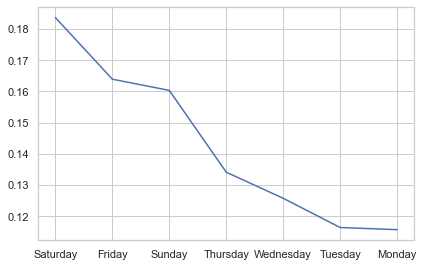

In [22]:
df.dayweek.value_counts(normalize=True).plot()

In [23]:
day_plot = df.dayweek.value_counts(normalize=True)

In [24]:
day_plot = {'Day': ['Monday', 'Tuesday', "Wednesday", 'Thursday', 'Friday', 'Saturday', "Sunday"], 'Value': [0.115713, 0.1164, 0.125771, 0.134130, 0.163941, 0.183694, 0.160353]}

In [25]:
pd.DataFrame(day_plot)

,Day,Value
0,Monday,0.115713
1,Tuesday,0.116400
2,Wednesday,0.125771
3,Thursday,0.134130
4,Friday,0.163941
5,Saturday,0.183694
6,Sunday,0.160353


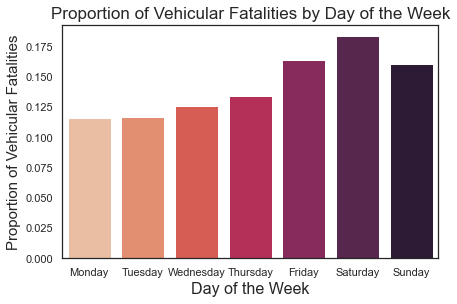

In [216]:
sns.barplot(x = 'Day', y = 'Value', data=day_plot, palette='rocket_r')
plt.title('Proportion of Vehicular Fatalities by Day of the Week', fontdict = {'fontsize': 17})
plt.xlabel('Day of the Week', fontdict = {'fontsize': 16})
plt.ylabel('Proportion of Vehicular Fatalities', fontdict = {'fontsize': 15})
#fig = plt.gcf()
#fig.savefig('Proportion of Vehicular Fatalities by Day of the Week palette.png', bbox_inches='tight')

In [27]:
df.age.value_counts()

18.0     1940
19.0     1782
20.0     1749
21.0     1590
22.0     1412
23.0     1406
17.0     1378
25.0     1220
24.0     1212
26.0     1140
27.0     1058
28.0     1019
29.0      999
30.0      931
32.0      910
31.0      900
36.0      849
33.0      844
34.0      785
35.0      752
40.0      749
16.0      746
37.0      700
39.0      695
38.0      691
41.0      688
43.0      646
46.0      632
45.0      632
42.0      624
44.0      594
48.0      580
47.0      579
49.0      570
50.0      570
51.0      530
52.0      509
54.0      494
53.0      489
56.0      473
55.0      469
15.0      469
60.0      465
62.0      462
61.0      448
59.0      447
57.0      436
65.0      424
70.0      424
76.0      421
66.0      420
73.0      418
80.0      413
78.0      410
69.0      410
58.0      410
75.0      404
63.0      397
74.0      387
67.0      386
64.0      384
79.0      383
68.0      382
77.0      373
72.0      365
71.0      348
81.0      337
82.0      322
83.0      292
14.0      292
84.0      275
86.0  

In [28]:
df.year.value_counts()

1989    2800
1990    2331
1991    2113
1995    2017
1992    1974
1996    1970
1993    1953
1994    1928
2000    1817
1997    1767
1999    1764
1998    1755
2001    1737
2002    1715
2005    1627
2003    1621
2007    1603
2006    1598
2004    1583
2009    1491
2008    1437
2010    1353
2012    1300
2016    1292
2011    1277
2017    1222
2015    1204
2013    1187
2019    1186
2014    1151
2018    1134
2020    1107
2021     383
Name: year, dtype: int64

<AxesSubplot:>

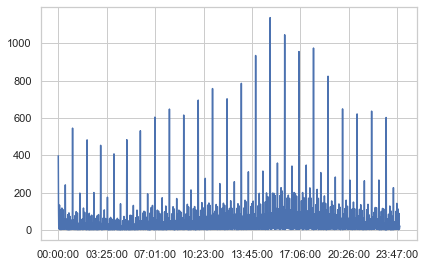

In [29]:
df.time.value_counts().sort_index().plot()

In [30]:
df.speed_limit.value_counts(normalize=True).sort_index(level='int')

10             0.000353
100            0.355008
110            0.116813
130            0.002215
15             0.000020
20             0.000549
25             0.000039
30             0.000274
40             0.006685
5              0.000059
50             0.055927
60             0.266736
70             0.049184
75             0.004979
80             0.118813
90             0.022210
<40            0.000098
Unspecified    0.000039
Name: speed_limit, dtype: float64

In [31]:
df.speed_limit.isnull().sum()

1384

In [32]:
df.time.value_counts()

15:00:00    1137
16:00:00    1045
18:00:00     974
17:00:00     955
14:00:00     934
19:00:00     823
13:00:00     785
11:00:00     757
12:00:00     702
10:00:00     695
20:00:00     648
08:00:00     647
22:00:00     636
21:00:00     621
09:00:00     615
07:00:00     604
23:00:00     602
01:00:00     545
06:00:00     531
05:00:00     483
02:00:00     482
03:00:00     453
04:00:00     407
00:00:00     397
15:30:00     358
17:30:00     347
16:30:00     342
14:30:00     315
13:30:00     311
18:30:00     307
19:30:00     283
10:30:00     276
22:30:00     267
20:30:00     267
21:30:00     263
12:30:00     258
11:30:00     248
00:30:00     241
15:45:00     226
23:30:00     226
17:45:00     225
18:15:00     217
09:30:00     214
15:50:00     208
02:30:00     200
16:40:00     200
17:15:00     200
14:45:00     198
01:30:00     197
15:10:00     197
15:15:00     196
14:15:00     196
16:45:00     195
06:30:00     193
16:15:00     186
15:20:00     184
15:40:00     183
18:45:00     182
16:50:00     1

<AxesSubplot:>

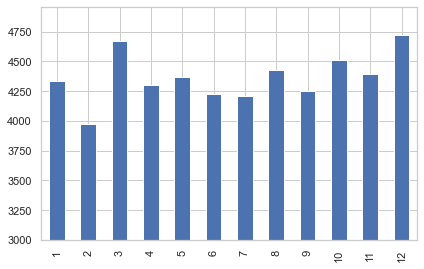

In [34]:
df.month.value_counts().sort_index().plot(kind='bar', ylim=3000)

In [35]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
month,52397.0,6.565586,3.470123,1.0,4.0,7.0,10.0,12.0
year,52397.0,2002.574193,9.264514,1989.0,1995.0,2002.0,2010.0,2021.0
age,52308.0,39.696719,21.720526,0.0,22.0,34.0,55.0,101.0


## Cleaning the data - null values, imputation etc.

In [36]:
df.isnull().sum()

state                               0
month                               0
year                                0
dayweek                             0
time                               40
crash_type                          0
bus_involvement                    16
articulated_truck_involvement      16
speed_limit                      1384
road_user                           0
gender                             28
age                                89
christmas_period                    0
easter_period                       0
age_group                           0
day_of_week                         0
time_of_day                         0
dtype: int64

In [37]:
df.crash_type.value_counts()

Single      28984
Multiple    23413
Name: crash_type, dtype: int64

In [38]:
df.bus_involvement.value_counts()

No     51402
Yes      979
Name: bus_involvement, dtype: int64

In [39]:
df.bus_involvement.isnull().sum()

16

In [40]:
df.bus_involvement = df.bus_involvement.fillna('No')

In [41]:
df.bus_involvement.value_counts()

No     51418
Yes      979
Name: bus_involvement, dtype: int64

In [42]:
df.articulated_truck_involvement.value_counts(normalize=True)

No     0.898685
Yes    0.101315
Name: articulated_truck_involvement, dtype: float64

In [43]:
df.articulated_truck_involvement = df.articulated_truck_involvement.fillna('No')

In [44]:
df.articulated_truck_involvement.value_counts()

No     47090
Yes     5307
Name: articulated_truck_involvement, dtype: int64

In [45]:
df.isnull().sum()

state                               0
month                               0
year                                0
dayweek                             0
time                               40
crash_type                          0
bus_involvement                     0
articulated_truck_involvement       0
speed_limit                      1384
road_user                           0
gender                             28
age                                89
christmas_period                    0
easter_period                       0
age_group                           0
day_of_week                         0
time_of_day                         0
dtype: int64

In [46]:
df.speed_limit.value_counts(normalize=True)

100            0.355008
60             0.266736
80             0.118813
110            0.116813
50             0.055927
70             0.049184
90             0.022210
40             0.006685
75             0.004979
130            0.002215
20             0.000549
10             0.000353
30             0.000274
<40            0.000098
5              0.000059
25             0.000039
Unspecified    0.000039
15             0.000020
Name: speed_limit, dtype: float64

In [47]:
#Will make the <40 as 40 and Unspecified as the median
df.speed_limit.replace('<40', 40, inplace=True)

In [48]:
df.speed_limit.replace('Unspecified', 0, inplace=True)

In [49]:
df.speed_limit.value_counts()

100    18110
60     13607
80      6061
110     5959
50      2853
70      2509
90      1133
40       341
75       254
130      113
20        28
10        18
30        14
40         5
5          3
25         2
0          2
15         1
Name: speed_limit, dtype: int64

In [50]:
df.speed_limit = pd.to_numeric(df.speed_limit)

In [51]:
df.speed_limit.median()

80.0

In [52]:
df.speed_limit.replace(0, 80, inplace=True)

In [53]:
#I will place the null values in the median speed as well
df.speed_limit.fillna(80, inplace=True)

<AxesSubplot:>

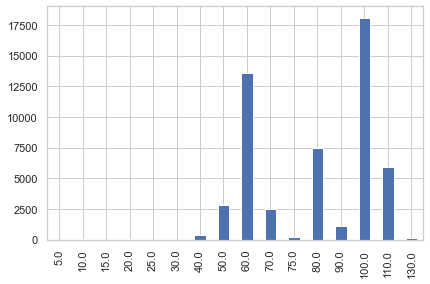

In [54]:
df.speed_limit.value_counts().sort_index().plot(kind='bar')

In [55]:
df.isnull().sum()

state                             0
month                             0
year                              0
dayweek                           0
time                             40
crash_type                        0
bus_involvement                   0
articulated_truck_involvement     0
speed_limit                       0
road_user                         0
gender                           28
age                              89
christmas_period                  0
easter_period                     0
age_group                         0
day_of_week                       0
time_of_day                       0
dtype: int64

<AxesSubplot:>

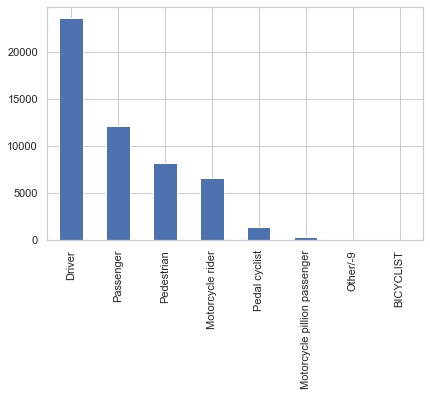

In [43]:
df.road_user.value_counts().plot(kind='bar')

In [57]:
#Will make the assumption that all 'other' road_users are passengers. There aren't that many observations so this shouldn't have a drastic effect.
df.road_user.replace('Other/-9', 'Passenger', inplace=True)

In [58]:
df.road_user.value_counts()

Driver                          23609
Passenger                       12270
Pedestrian                       8183
Motorcycle rider                 6564
Pedal cyclist                    1407
Motorcycle pillion passenger      362
BICYCLIST                           2
Name: road_user, dtype: int64

In [59]:
df.gender.value_counts()

Male           37491
Female         14877
Unspecified        1
Name: gender, dtype: int64

In [60]:
df.gender.isnull().sum()

28

In [61]:
df.groupby("gender")["age"].median()

gender
Female         40.0
Male           33.0
Unspecified     0.0
Name: age, dtype: float64

In [66]:
df.age.fillna(df.groupby(by=['gender'])['age'].transform("median"), inplace=True)

In [67]:
df.age.isnull().sum()

7

In [74]:
df.age.fillna(df.age.median(), inplace=True)

In [75]:
df.loc[df.age.isnull()]

,state,month,year,dayweek,time,crash_type,bus_involvement,articulated_truck_involvement,speed_limit,road_user,gender,age,christmas_period,easter_period,age_group,day_of_week,time_of_day
Crash ID,,,,,,,,,,,,,,,,,


In [76]:
df.gender.fillna('Male', inplace=True)

In [77]:
df.gender.replace('Unspecified', 'Male', inplace=True)

In [78]:
df.loc[df.gender.isnull()]

,state,month,year,dayweek,time,crash_type,bus_involvement,articulated_truck_involvement,speed_limit,road_user,gender,age,christmas_period,easter_period,age_group,day_of_week,time_of_day
Crash ID,,,,,,,,,,,,,,,,,


In [119]:
print(df.christmas_period.value_counts(), '\n')
print(df.easter_period.value_counts(), '\n')
print(df.age_group.value_counts(), '\n')
print(df.day_of_week.value_counts(), '\n')
print(df.time_of_day.value_counts())

No     50762
Yes     1635
Name: christmas_period, dtype: int64 

No     52151
Yes      246
Name: easter_period, dtype: int64 

17_to_25       13689
40_to_64       13307
26_to_39       12332
75_or_older     5051
0_to_16         4054
65_to_74        3964
Name: age_group, dtype: int64 

Weekday    30780
Weekend    21617
Name: day_of_week, dtype: int64 

Day      29847
Night    22550
Name: time_of_day, dtype: int64


In [105]:
df.loc[df.age_group == 'Unknown']

,state,month,year,dayweek,time,crash_type,bus_involvement,articulated_truck_involvement,speed_limit,road_user,gender,age,christmas_period,easter_period,age_group,day_of_week,time_of_day
Crash ID,,,,,,,,,,,,,,,,,
20212036,Vic,2,2021,Thursday,08:00:00,Multiple,No,No,90.0,Passenger,Female,40.0,No,No,Unknown,Weekday,Day
20202030,Vic,4,2020,Wednesday,17:30:00,Multiple,No,Yes,100.0,Pedestrian,Male,34.0,No,No,Unknown,Weekday,Day
20202030,Vic,4,2020,Wednesday,17:30:00,Multiple,No,Yes,100.0,Pedestrian,Male,34.0,No,No,Unknown,Weekday,Day
20202030,Vic,4,2020,Wednesday,17:30:00,Multiple,No,Yes,100.0,Pedestrian,Male,34.0,No,No,Unknown,Weekday,Day
20202030,Vic,4,2020,Wednesday,17:30:00,Multiple,No,Yes,100.0,Pedestrian,Male,34.0,No,No,Unknown,Weekday,Day
20185139,WA,12,2018,Sunday,15:18:00,Multiple,Yes,No,110.0,Passenger,Male,33.0,No,No,Unknown,Weekend,Day
20185139,WA,12,2018,Sunday,15:18:00,Multiple,Yes,No,110.0,Passenger,Male,33.0,No,No,Unknown,Weekend,Day
20185038,WA,7,2018,Tuesday,04:00:00,Single,No,No,110.0,Driver,Male,33.0,No,No,Unknown,Weekday,Night
20185015,WA,1,2018,Monday,02:50:00,Single,No,No,50.0,Driver,Female,40.0,No,No,Unknown,Weekend,Night


In [108]:
thirties = (df['age'] >= 32) & (df['age'] < 40)
df.loc[thirties, 'age_group'] = '26_to_39'
forties = (df['age'] >= 40) & (df['age'] <=64)
df.loc[forties, 'age_group'] = '40_to_64'

In [111]:
df.age_group.value_counts()

17_to_25       13689
40_to_64       13307
26_to_39       12332
75_or_older     5051
0_to_16         4054
65_to_74        3964
Name: age_group, dtype: int64

<AxesSubplot:>

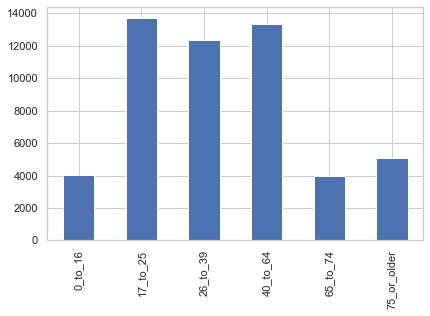

In [114]:
df.age_group.value_counts().sort_index().plot(kind='bar')

In [ ]:
df.age_group.value_counts().sort_index().to_frame

In [115]:
df.dtypes

state                             object
month                              int64
year                               int64
dayweek                           object
time                              object
crash_type                        object
bus_involvement                   object
articulated_truck_involvement     object
speed_limit                      float64
road_user                         object
gender                            object
age                              float64
christmas_period                  object
easter_period                     object
age_group                         object
day_of_week                       object
time_of_day                       object
dtype: object

In [116]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
month,52397.0,6.565586,3.470123,1.0,4.0,7.0,10.0,12.0
year,52397.0,2002.574193,9.264514,1989.0,1995.0,2002.0,2010.0,2021.0
speed_limit,52397.0,82.976888,20.309022,5.0,60.0,80.0,100.0,130.0
age,52397.0,39.689486,21.703196,0.0,22.0,34.0,55.0,101.0


In [195]:
age_group_sort = df.age_group.value_counts().sort_index().to_frame()
age_group_sort

,age_group
0_to_16,4054
17_to_25,13689
26_to_39,12332
40_to_64,13307
65_to_74,3964
75_or_older,5051


Text(0, 0.5, 'Number')

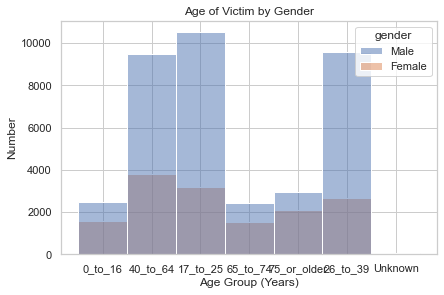

In [103]:
sns.histplot(x=df.age_group, data=df, hue=df.gender)
plt.title('Age of Victim by Gender')
plt.xlabel('Age Group (Years)')
plt.ylabel('Number')

In [201]:
sns.countplot(data=age_group_sort, hue=df.gender, palette = 'mako')
plt.title('Age of Victim by Gender')
plt.xlabel('Age Group (Years)')
plt.ylabel('Number')

ValueError: Cannot use `hue` without `x` and `y`

In [117]:
df.isnull().sum()

state                             0
month                             0
year                              0
dayweek                           0
time                             40
crash_type                        0
bus_involvement                   0
articulated_truck_involvement     0
speed_limit                       0
road_user                         0
gender                            0
age                               0
christmas_period                  0
easter_period                     0
age_group                         0
day_of_week                       0
time_of_day                       0
dtype: int64

In [118]:
print(df.day_of_week.value_counts(), '\n')
print(df.time_of_day.value_counts())

Weekday    30780
Weekend    21617
Name: day_of_week, dtype: int64 

Day      29847
Night    22550
Name: time_of_day, dtype: int64


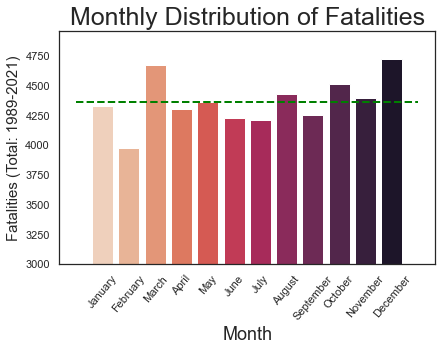

In [207]:
sns.countplot(x=df.month, data=df, palette = 'rocket_r', tick_label = month_dict)
plt.plot([-1, 12], [4366, 4366],color='green', linestyle='dashed',linewidth=2)
plt.xlabel('Month', fontdict = {'fontsize': 18})
plt.ylabel('Fatalities (Total: 1989-2021)', fontdict = {'fontsize': 15})
plt.title('Monthly Distribution of Fatalities', fontdict = {'fontsize': 25})
plt.ylim(3000)
plt.xticks([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11]
       , ['January', 'February', 'March', 'April', 'May', 'June', 'July', 'August', 'September', 'October', 'November', 'December']
       , rotation=50) 
fig = plt.gcf()
fig.savefig('Monthly Distribution of Fatalities.png', bbox_inches='tight')

In [145]:
df.month.value_counts().mean()

4366.416666666667

## Sorting df.time into datetime data type

In [204]:
df.dtypes

state                             object
month                              int64
year                               int64
dayweek                           object
time                              object
crash_type                        object
bus_involvement                   object
articulated_truck_involvement     object
speed_limit                      float64
road_user                         object
gender                            object
age                              float64
christmas_period                  object
easter_period                     object
age_group                         object
day_of_week                       object
time_of_day                       object
dtype: object